# Libraries

In [1]:
'''Main'''
import numpy as np
import pandas as pd
import os, time, re
import pickle, gzip
from random import randint
import math
import re

'''Data Viz'''
import matplotlib.pyplot as plt
from matplotlib.pyplot import hist
import matplotlib.cm as cm
import seaborn as sns
color = sns.color_palette()
import matplotlib as mpl

%matplotlib inline

'''Data Prep and Model Evaluation'''
from sklearn import preprocessing as pp
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split 
from sklearn.model_selection import StratifiedKFold 
from sklearn.metrics import log_loss
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import roc_curve, auc, roc_auc_score
import joblib 

'''Algos'''
#import lightgbm as lgb

'''TensorFlow and Keras'''
import tensorflow as tf
import keras
from keras import backend as K
from keras.models import Sequential, Model, load_model
from keras.layers import Activation, Dense, Dropout
from keras.layers import BatchNormalization, Input, Lambda
from keras import regularizers
from keras.losses import mse, binary_crossentropy

from osgeo import gdal
from osgeo import gdal_array
import matplotlib.pyplot as plt
import numpy as np
import sys
from osgeo.gdalconst import *
import os

import math
import codecs

import osgeo #this is necessary for the type comparison in some methods
from osgeo import osr
from osgeo import ogr
from collections import defaultdict
import itertools
from osgeo import gdal_array as gdar
from osgeo import gdalconst as gdct
import glob

# Inputs

In [2]:
path_images = '/Users/clara/Projects/A4_Cube/Images/Strobler/'
bands = ['Cloud','B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B10', 'B11', 'B12']
model_filepath = '/Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/'
figures_filepath = '/Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Figures/'
n_pixels = 1
n_clusters = 8
n_dim = 3

# Data from .tif images

**UPLOAD TIFF AND CUSTOMIZE ARRAY**

In [3]:
def is_leap_year(year):
    """ if year is a leap year return True
        else return False """
    if year % 100 == 0:
        return year % 400 == 0
    return year % 4 == 0

def doy(Y,M,D):
    """ given year, month, day return day of year
        Astronomical Algorithms, Jean Meeus, 2d ed, 1998, chap 7 """
    if is_leap_year(Y):
        K = 1
    else:
        K = 2
    N = int((275 * M) / 9.0) - K * int((M + 9) / 12.0) + D - 30
    return N

In [4]:
#Train
trainArray = []
ymds = []
doys = []

files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.', 'm')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
        # Bands
        tif = gdal_array.LoadFile(path_images+f)
        tif = np.delete(tif, 0, axis=0)
        tif = np.delete(tif, 10, axis=0)
        tif = tif/6000
        
        # DOY: t1, t2
        Y_M_D = re.sub("[^0-9]", "", f)
        ymds.append(Y_M_D)
        d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
        doys.append(d)
        t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
        t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
        t1_t2 = np.stack([t1, t2], axis=0)
        
        # Join
        tif = np.concatenate([tif, t1_t2], axis=0)
        print(tif.shape)
        trainArray.append(tif)

trainArray = np.stack(trainArray, axis = 0)

print(f'''-> Files:
{files}''')
print(f'-> Dates: {ymds}')
print(f'-> DOYs: {doys}')
print(f'-> tifArray shape: {trainArray.shape}')

(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
(14, 193, 354)
-> Files:
['.DS_Store', 'Strobbler_clean_Image_01042017.tif', 'Strobbler_clean_Image_01042017.tif.aux.xml', 'Strobbler_clean_Image_02082017.tif', 'Strobbler_clean_Image_02082017.tif.aux.xml', 'Strobbler_clean_Image_04082018.tif', 'Strobbler_clean_Image_04082018.tif.aux.xml', 'Strobbler_clean_Image_05072017.ti

In [5]:
#ATENCIÓN:
#Test (tiene diferente shape por eso lo hago a parte, de normal las cargaría todas juntas y después dividiría train y test)

# Bands
tif = gdal_array.LoadFile('/Users/clara/Projects/A4_Cube/Images/Strobler/Test/Strobbler_clean_Image_27082019.tif')
tif = np.delete(tif, 0, axis=0)
tif = np.delete(tif, 10, axis=0)
tif = tif/6000

# DOY: t1, t2
Y_M_D = '27082019'
d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
print(f'DOY: {d}')
t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
t1_t2 = np.stack([t1, t2], axis=0)

# Join
testArray = np.concatenate([tif, t1_t2], axis=0)
testArray.shape

DOY: 239


(14, 193, 354)

In [6]:
bands = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 't1', 't2']
print(f'New name bands: {bands}')

New name bands: ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 't1', 't2']


# True color composite

In [ ]:
# Fill in number of figures:
n_figures = trainArray.shape[0]

# Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'True Color Composite', fontsize = 50)

# Plot images
for sp in range(n_figures):
    image = trainArray[sp]
    img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
    img = np.clip(img, 0, 1)
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(np.array(img))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'Image DOY: {doys[sp]} and Date: {ymds[sp]}', fontsize=20)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# save
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/original_images.png', format='png', dpi=300)
plt.show()

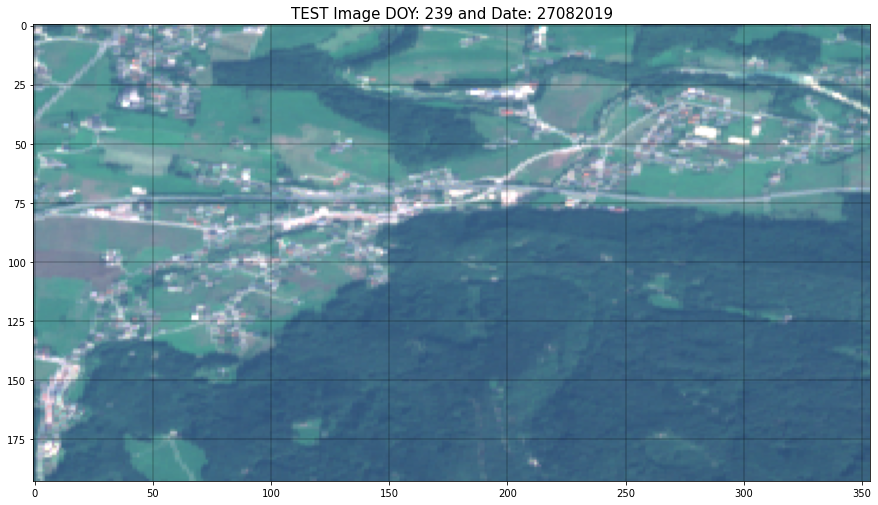

In [8]:
plt.figure(figsize = (15,15))
image = testArray
img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'TEST Image DOY: {d} and Date: {Y_M_D}', fontsize=15)
plt.savefig(f'{figures_filepath}/original_images_flood.png', format='png', dpi=300)
plt.show()

Flood Mask shape: (191, 352)


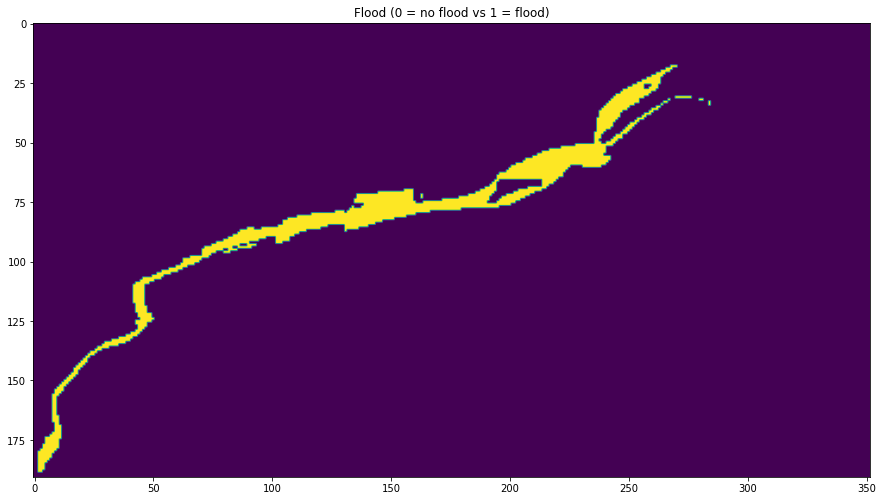

In [9]:
files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.','Strobler', 'Test')) and os.path.isfile(os.path.join(path_images, f)):
        # Labels
        flood = gdal_array.LoadFile(path_images+f)
print(f'Flood Mask shape: {flood.shape}')
plt.figure(figsize = (15,15))
plt.title ('Flood (0 = no flood vs 1 = flood)')
plt.savefig(f'{figures_filepath}/flood_mask.png', format='png', dpi=300)
plt.imshow(flood)

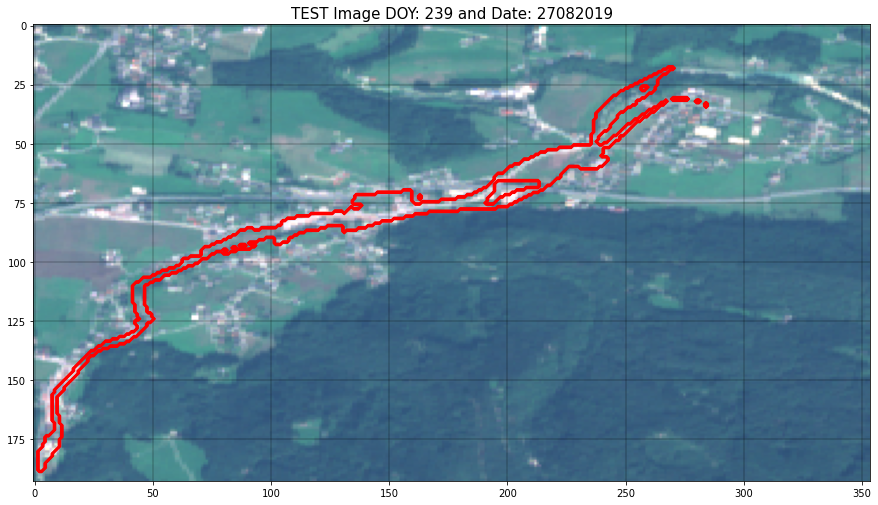

In [10]:
plt.figure(figsize = (15,15))
image = testArray
img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.contour(flood==1, colors='red', linewidths=1.5)
plt.grid(color='black', linewidth=0.3)
plt.title(f'TEST Image DOY: {d} and Date: {Y_M_D}', fontsize=15)
plt.savefig(f'{figures_filepath}/original_images_floodBound.png', format='png', dpi=300)
plt.show()

# Prepare data for AE and Clustering

**CLUSTERING**

In [7]:
from sklearn.preprocessing import StandardScaler
array_kmeans = trainArray[:,:-2, :,:]
array_kmeans = np.transpose(array_kmeans.reshape(array_kmeans.shape[0]*array_kmeans.shape[1], array_kmeans.shape[2]*array_kmeans.shape[3]))
scaler = StandardScaler().fit(array_kmeans)
array_kmeans = scaler.transform(array_kmeans)
array_kmeans.shape

(68322, 552)

**PREDICT TRAINING**

In [8]:
# Reshape: images, bands, rows*columns
TRAINarray_ae = trainArray.reshape(trainArray.shape[0], trainArray.shape[1], trainArray.shape[2]*trainArray.shape[3])
# Join per images: bands, images*rows*columns
TRAINarray_ae = np.concatenate(TRAINarray_ae, axis=1)
# Transpose: images*rows*columns, bands
TRAINarray_ae = TRAINarray_ae.transpose()
TRAINarray_ae.shape

(3142812, 14)

**PREDICT TESTING**

In [9]:
# Reshape: images, bands, rows*columns
array_ae = testArray.reshape(testArray.shape[0], testArray.shape[1]*testArray.shape[2])
# Transpose: images*rows*columns, bands
array_ae = array_ae.transpose()
array_ae.shape

(68322, 14)

# Pre-clustering

**Apply PCA**

In [10]:
from sklearn.decomposition import PCA
pca = PCA(n_components = n_dim)
pca.fit(array_kmeans)
pca_array_kmeans = pca.transform(array_kmeans)
print(f'PCA shape: {pca_array_kmeans.shape}')

PCA shape: (68322, 3)


**Represent dimensions**

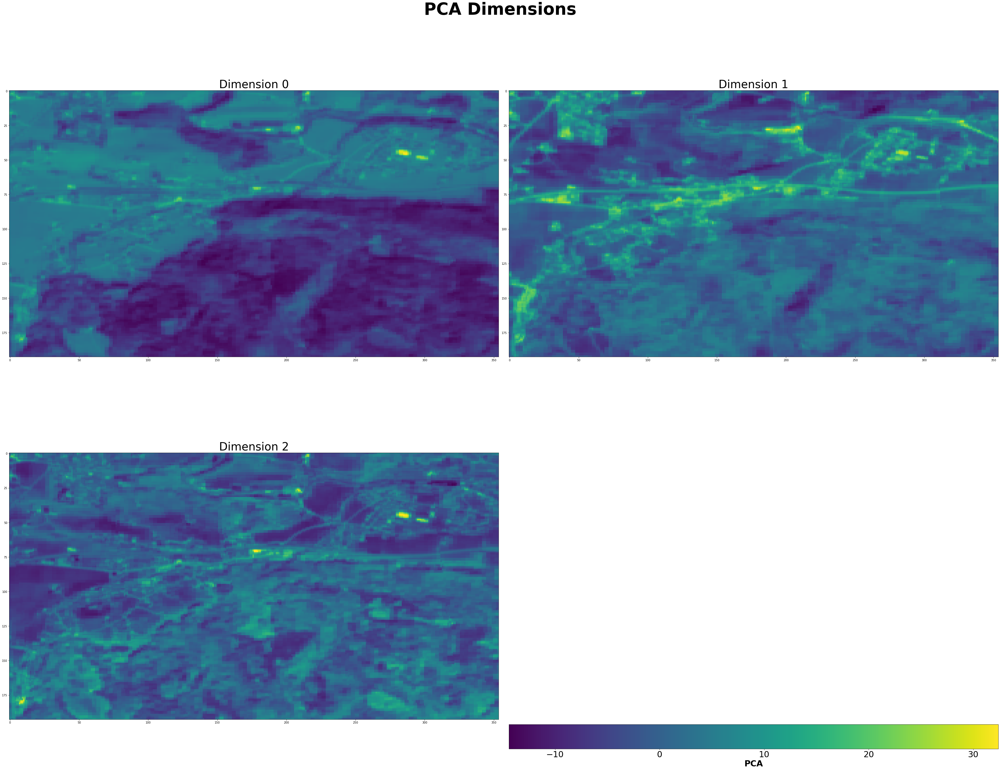

In [22]:
represent = pca_array_kmeans.reshape(trainArray.shape[2],trainArray.shape[3], n_dim)

# Fill in number of figures:
n_figures = n_dim

# Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'PCA Dimensions', fontsize = 60, fontweight="bold")

# Plot images
for sp in range(n_figures):
    ax = axs[rows[sp], columns[sp]]
    img = represent[:,:,sp]
    img = ax.imshow(np.array(img))
    ax.set_title(f'Dimension {sp}', fontsize=40)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()
    
# colorbar
cb = plt.colorbar(img, orientation="horizontal", pad=0.15)
cb.set_label(label='PCA', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/PCA_dimensions.png', format='png', dpi=300)
plt.show()

**Show data distribution**

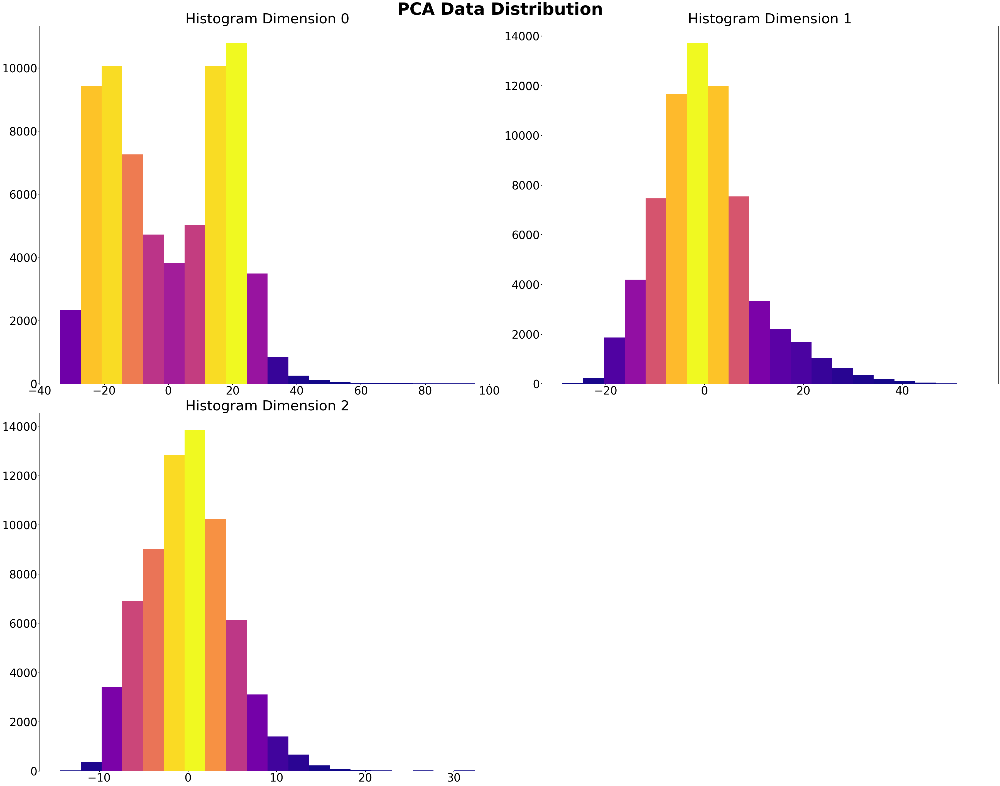

In [31]:
# Libraries
from matplotlib import colors
from matplotlib.ticker import PercentFormatter

# Fill in number of figures:
n_figures = n_dim

# Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'PCA Data Distribution', fontsize = 60, fontweight="bold")

# Plot images
for sp in range(n_figures):
    ax = axs[rows[sp], columns[sp]]
    ax.tick_params(labelsize=40, width=3)
    ax.set_title(f'Histogram Dimension {sp}', fontsize=50)
    # N is the count in each bin, bins is the lower-limit of the bin
    N, bins, patches = ax.hist(pca_array_kmeans[:,sp], bins = 20)
    # We'll color code by height, but you could use any scalar
    fracs = N / N.max()
    # we need to normalize the data to 0..1 for the full range of the colormap
    norm = colors.Normalize(fracs.min(), fracs.max())
    # Now, we'll loop through our objects and set the color of each accordingly
    for thisfrac, thispatch in zip(fracs, patches):
        color = plt.cm.plasma(norm(thisfrac))
        thispatch.set_facecolor(color)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# save
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/PCA_Histograms.png', format='png', dpi=300)
plt.show()

densitybool, default: False
If True, draw and return a probability density: each bin will display the bin's raw count divided by the total number of counts and the bin width (density = counts / (sum(counts) * np.diff(bins))), so that the area under the histogram integrates to 1 (np.sum(density * np.diff(bins)) == 1).

If stacked is also True, the sum of the histograms is normalized to 1.

In [11]:
ejemplo = pca_array_kmeans[:,0]

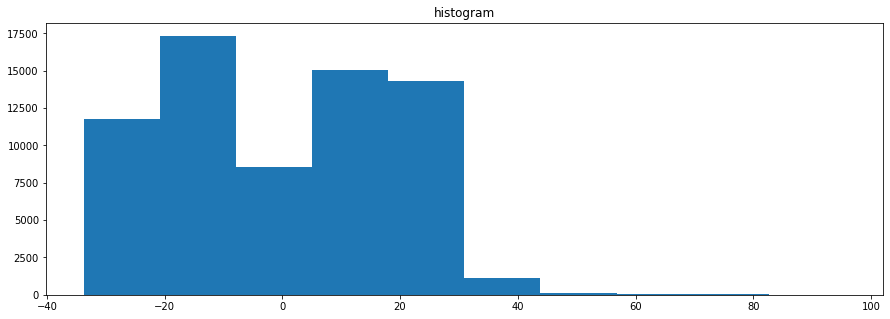

In [15]:
plt.figure(figsize=(15,5))
plt.hist(ejemplo) #bins = [0,20,40,60,80,100]
plt.title("histogram") 
plt.show()

# Clustering

In [12]:
# Train K-means
n_features = pca_array_kmeans.shape[1]
print('Training the algorithm...')
start = time.time()
means = KMeans(n_clusters=n_clusters, n_init = 20, random_state = 1996).fit(pca_array_kmeans)
end = time.time()
print(f'--- minutes ---- {(end - start)/60}')

Training the algorithm...
--- minutes ---- 0.04232996702194214


In [13]:
labels = means.labels_.reshape(trainArray.shape[2], trainArray.shape[3])

<Figure size 432x288 with 0 Axes>

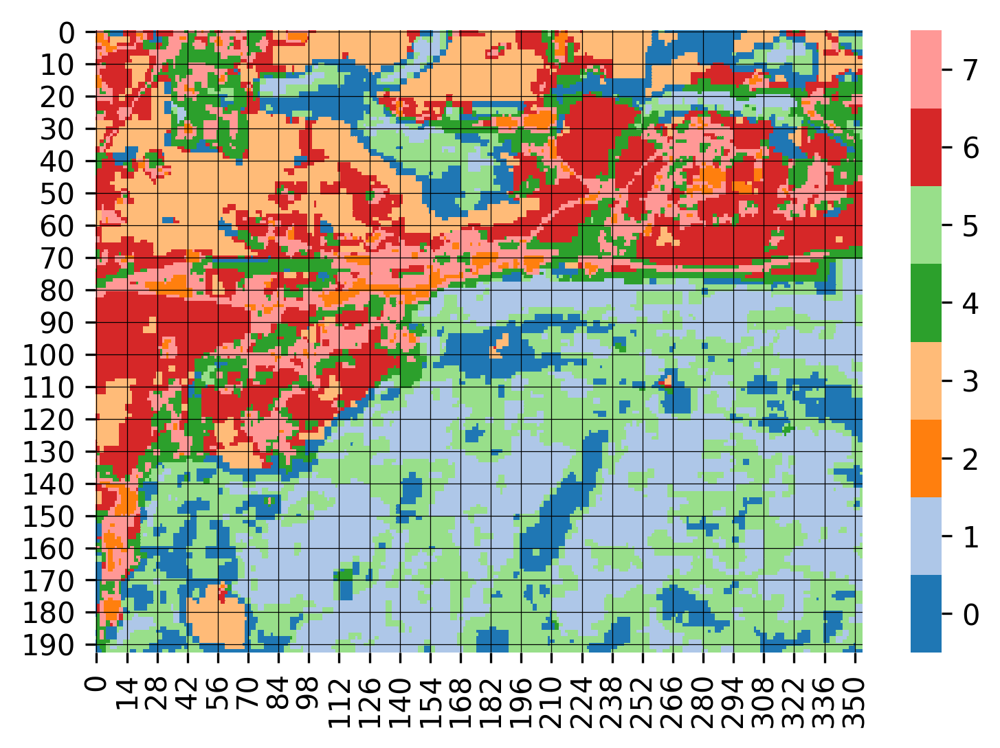

In [14]:
plt.figure()
# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(labels, cmap=cmap) 
# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)
plt.savefig(f'{figures_filepath}/clusters.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE BY CLUSTERS**

<Figure size 432x288 with 0 Axes>

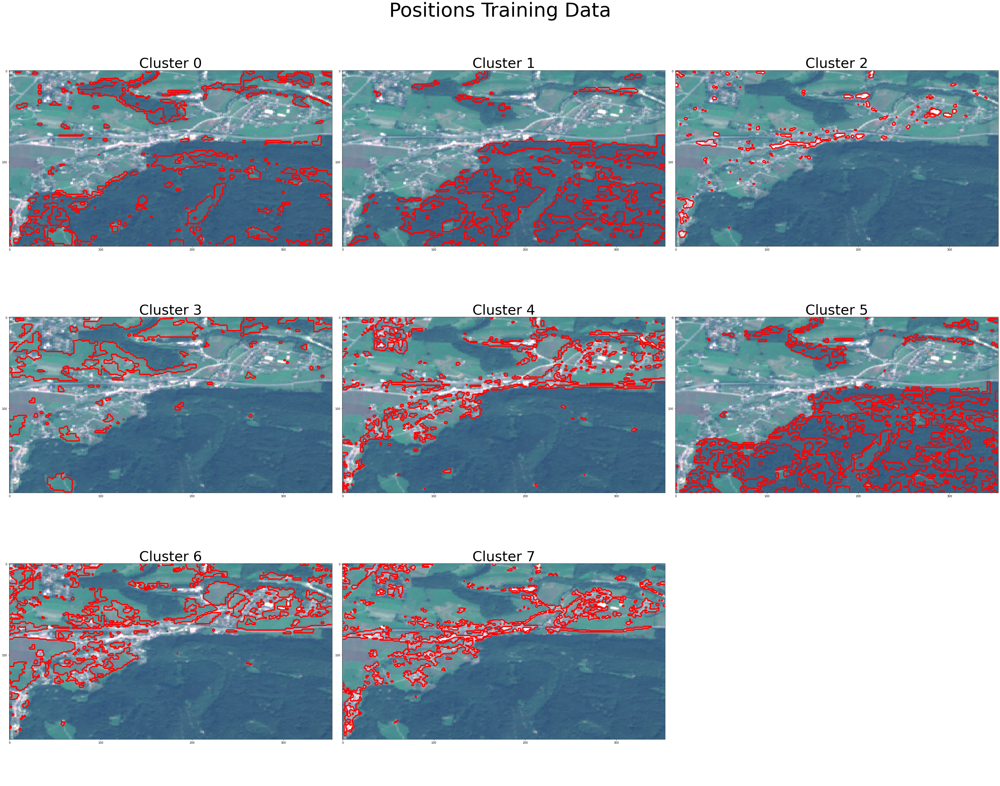

In [15]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Training Data', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    image = testArray
    img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
    img = np.clip(img, 0, 1)
    img = ax.imshow(img)
    ax.contour(cluster, colors='red', linewidths=1.5)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/clusters_TCC.png', format='png', dpi=300)
plt.show()

**DIFFERENCES BETWEEN CLUSTERS**

- Function to get the positions of all pixels differenciated by their cluster

In [16]:
allClusters_pixels = []
for cluster in range(n_clusters):
    cluster = labels == cluster
    result=np.where(cluster)
    pixels = list(zip(result[0], result[1]))
    allClusters_pixels.append(pixels)
print(f'len:{len(allClusters_pixels)}')

len:8


- Get data per cluster and represent

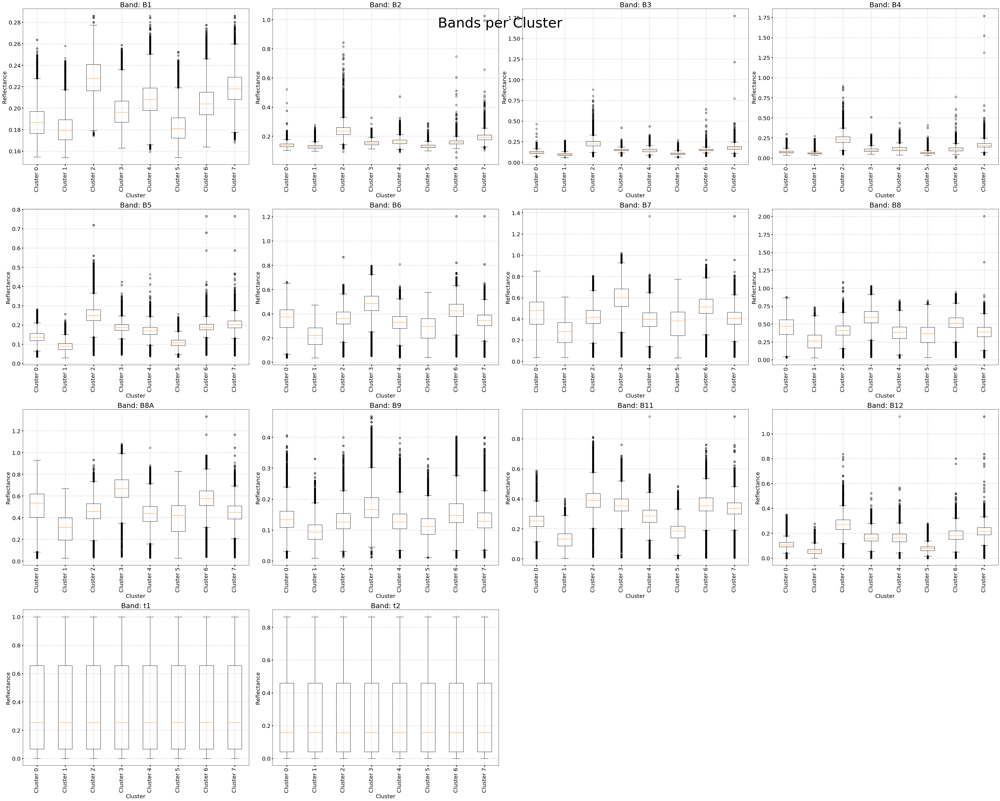

In [17]:
#Fill in number of figures:
n_figures = trainArray.shape[1]

#Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

#Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Bands per Cluster', fontsize = 50)

##Plot random selection of pixels per band
for sp in range(n_figures):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = allClusters_pixels[cluster]
        for img in range(trainArray.shape[0]):
            for pixel in pixels:
                pixel = trainArray[img, sp, int(pixel[0]), int(pixel[1])]
                data_cluster.append(pixel)
        data.append(data_cluster)
    data = np.array(data, dtype=object)
    
    # Customize band plot
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

#delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

#save
plt.tight_layout()
fig.subplots_adjust(top=0.99)
plt.savefig(f'{figures_filepath}/boxplots_clusters.png', format='png', dpi=300)
plt.show()

# Get training pixels

**REPRESENTATIVENESS OF EACH PIXEL TO ITS CLUSTER**

Shape: (193, 354)


<Figure size 432x288 with 0 Axes>

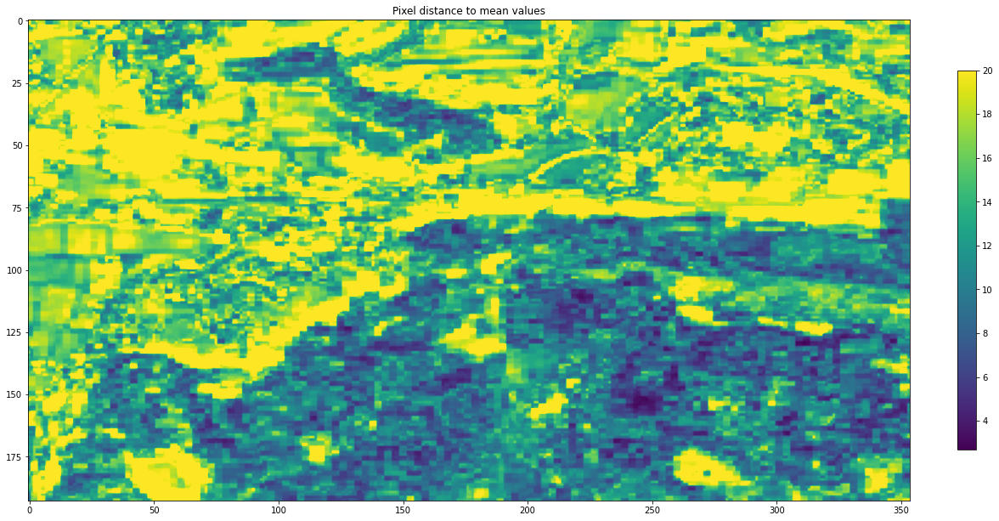

In [18]:
plt.figure()
# reshape to only bands
band_axis = np.concatenate(trainArray, axis=0)

# calculate sum of the difference per pixel to the mean of each band in its cluster
represent = []
for c in range(n_clusters):
    # select cluster
    cluster = band_axis*(labels == c)
    # difference to the mean per band
    diff_bands = []
    for b in cluster:
        diff = abs(b - np.full((trainArray.shape[2], trainArray.shape[3]), (np.sum(b)/np.count_nonzero(b)))*(labels == c))
        diff_bands.append(diff)
    diff_bands = np.array(diff_bands)

    # sum of the differences for all bands
    cluster_diff_bands = np.sum(diff_bands, axis=0)
    represent.append(cluster_diff_bands)

# Join all clusters for representation
represent = np.sum(np.array(represent), axis=0)
print(f'Shape: {represent.shape}')

# represent values
plt.figure(figsize=(20,20))
plt.imshow(represent, vmax=20)
plt.title('Pixel distance to mean values')
plt.colorbar(fraction=0.02)
plt.savefig(f'{figures_filepath}/pixel_representativity.png', format='png', dpi=300)
plt.show()

**SELECTION OF MOST REPRESENTATIVE PIXELS**

In [19]:
n_pixels = n_pixels
rep_pix_allCluster = []
for c in range(n_clusters):
    cluster = represent*(labels == c)
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rep_pix_cluster = []
    for i in range(n_pixels):
        minval = np.nanmin(cluster[np.nonzero(cluster)])
        print(f'Min difference: {minval}')
        pixel = [(ix,iy) for ix, row in enumerate(cluster) for iy, i in enumerate(row) if i == minval][0]
        rep_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
        cluster[pixel[0]][pixel [1]] = 0
    print(f'Pixel Locations: {rep_pix_cluster}')
    rep_pix_allCluster.append(rep_pix_cluster)

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Min difference: 5.3491586861559135
Pixel 0: (103, 199)
Pixel Locations: [(103, 199)]
---------------------------------------------------------------------------------------
Cluster: 1
---------------------------------------------------------------------------------------
Min difference: 2.6832059224738405
Pixel 0: (129, 311)
Pixel Locations: [(129, 311)]
---------------------------------------------------------------------------------------
Cluster: 2
---------------------------------------------------------------------------------------
Min difference: 7.954033834586469
Pixel 0: (2, 56)
Pixel Locations: [(2, 56)]
---------------------------------------------------------------------------------------
Cluster: 3
---------------------------------------------------------------------------------------
Min 

**SHOW POSITIONS IN MAP**

<Figure size 432x288 with 0 Axes>

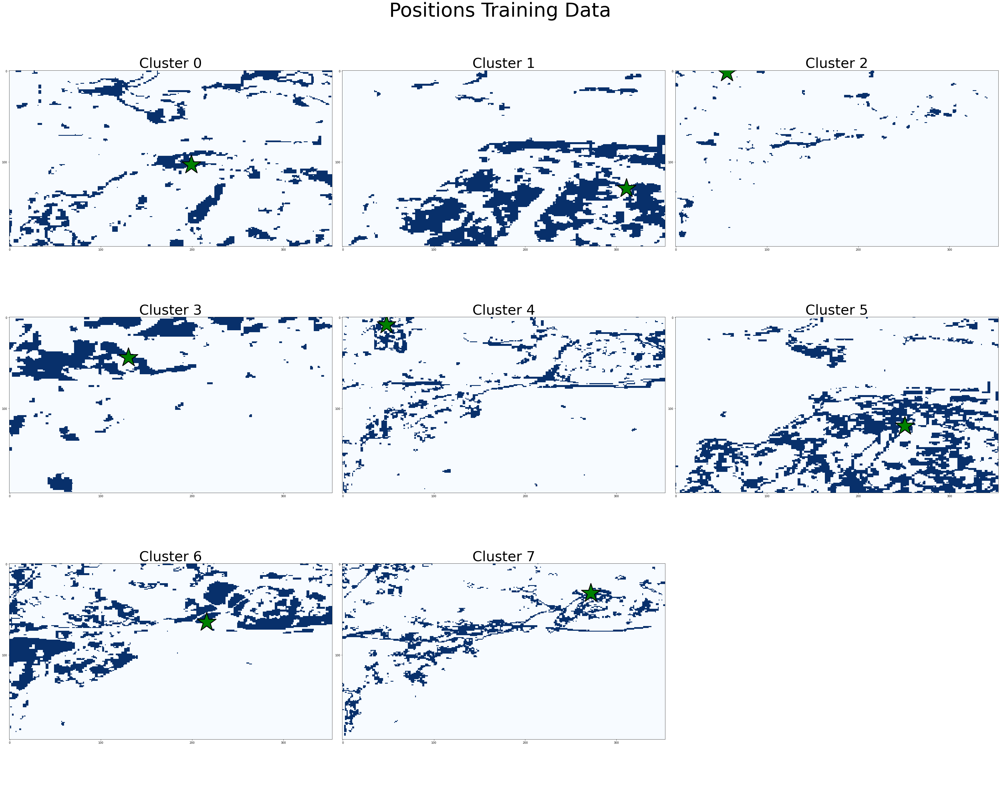

In [20]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Training Data', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    pixels = rep_pix_allCluster[sp]
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(cluster, cmap='Blues', interpolation='nearest')
    for pixel in pixels:
        ax.scatter(pixel[1], pixel[0],color = 'green', marker='*', s=5000, edgecolor='black', linewidth=3)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/training_pixel_positions.png', format='png', dpi=300)
plt.show()

**GET TRAINING DATA**

In [21]:
training_data = []
for b in range(len(bands)):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = rep_pix_allCluster[cluster]
        for img in range(trainArray.shape[0]):
            for pixel in pixels:
                pixel = trainArray[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    training_data.append(data)
training_data = np.array(training_data)
print('bands, clusters, images x pixels')
print(training_data.shape)

bands, clusters, images x pixels
(14, 8, 46)


**SHOW TRAINING DATA: BOXPLOTS**

<Figure size 432x288 with 0 Axes>

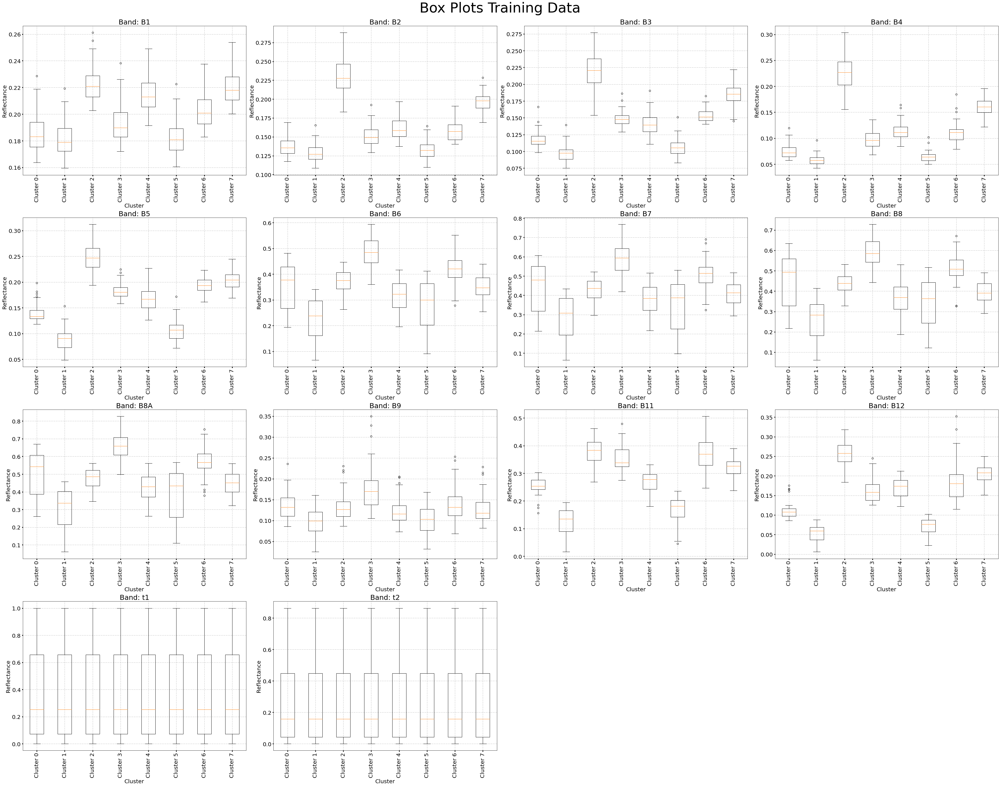

In [22]:
plt.figure()
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Box Plots Training Data', fontsize = 50)

# Represent Data
for sp in range(n_figures):     
    data = training_data[sp]
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/boxplots_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS**

<Figure size 432x288 with 0 Axes>

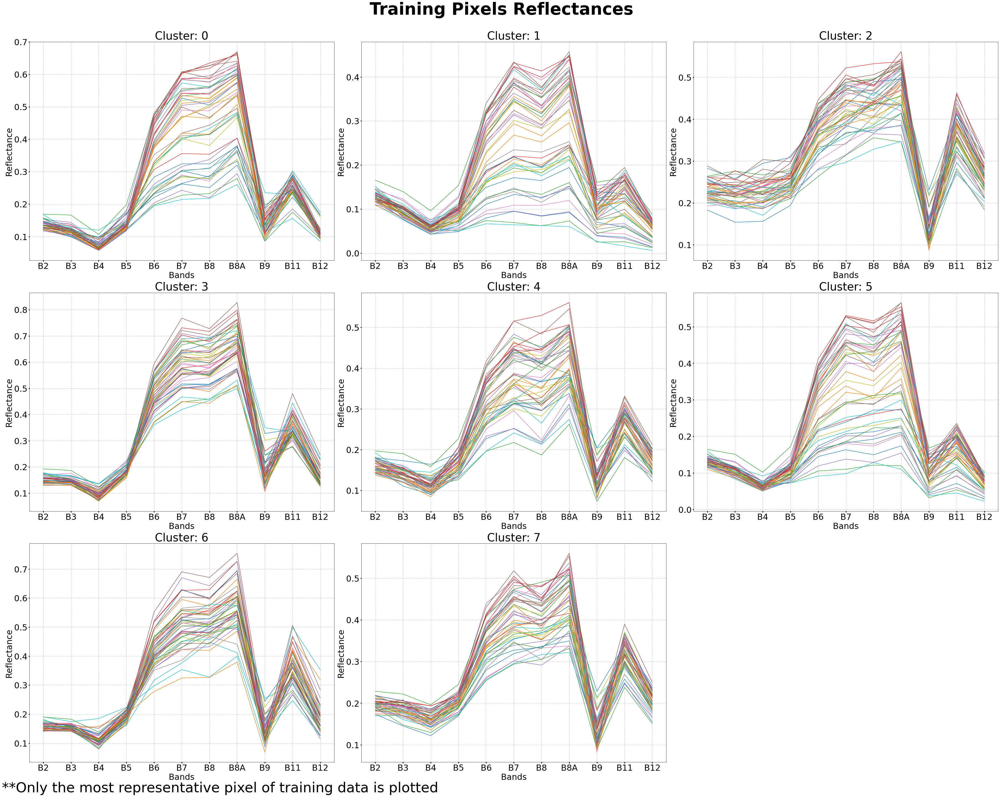

In [23]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Training Pixels Reflectances', fontsize = 60, fontweight="bold")

# Represent Data
for sp in range(n_figures):     
    data = training_data[1:-2,sp,:]
    ax = axs[rows[sp], columns[sp]]
    ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('Bands', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=30, width=3)
    ax.set_xticks(range(data.shape[0]))
    ax.set_xticklabels(bands[1:-2]);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# add a comment
textstr = '**Only the most representative pixel of training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShape_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS ALONG TIME**

<Figure size 432x288 with 0 Axes>

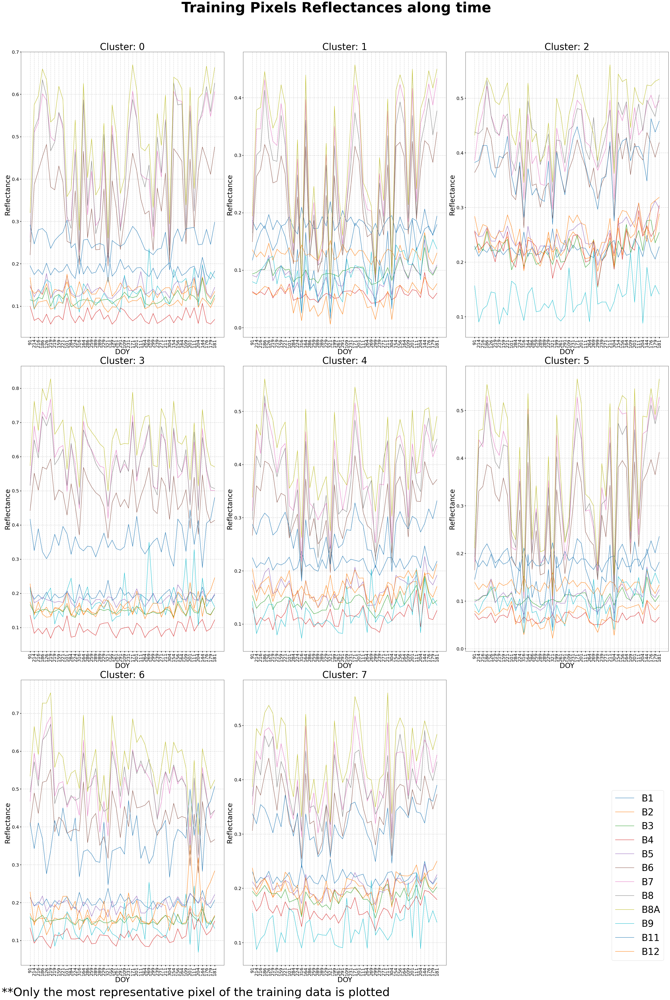

In [24]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Training Pixels Reflectances along time', fontsize = 60, fontweight="bold")

# Represent Data
for sp in range(n_figures):     
    data = np.transpose(training_data[:-2,sp,:])
    ax = axs[rows[sp], columns[sp]]
    im = ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('DOY', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    ax.set_xticks(range(data.shape[0]))
    ax.set_xticklabels(doys, rotation=90);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()
    
# legend
leg = plt.legend(im, bands[:-2], loc=4, fontsize = 40)

# add a comment
textstr = '**Only the most representative pixel of the training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShapeAlongTime_training.png', format='png', dpi=300)
plt.show()

---------------------------------------------------------------------------------------------------------

# Autoencoder

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00088: early stopping
Min error: 0.006988456007093191
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_0/assets


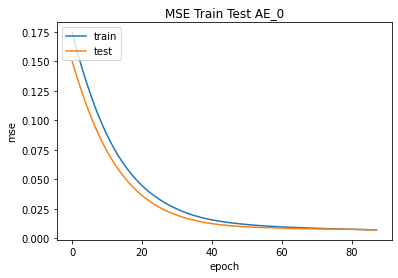

Epoch 00149: early stopping
Min error: 0.005285278894007206
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_0/assets


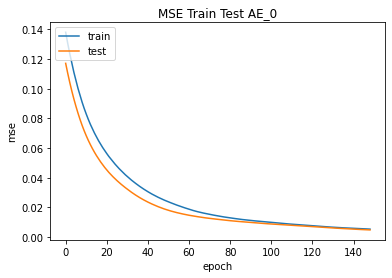

Epoch 00147: early stopping
Min error: 0.008633765392005444
Min error: 0.006814217194914818
Min error: 0.006246504373848438
Min error: 0.011246932670474052
-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00133: early stopping
Min error: 0.007604188285768032
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_1/assets


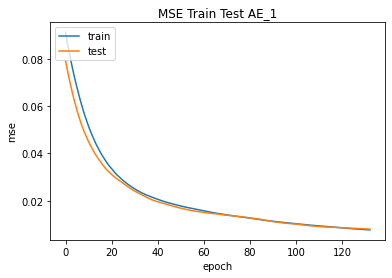

Epoch 00108: early stopping
Min error: 0.0033021355047822
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_1/assets


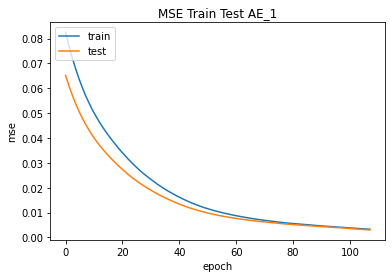

Epoch 00150: early stopping
Min error: 0.005828036926686764
Epoch 00137: early stopping
Min error: 0.0060387346893548965
Epoch 00117: early stopping
Min error: 0.002825070172548294
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_1/assets


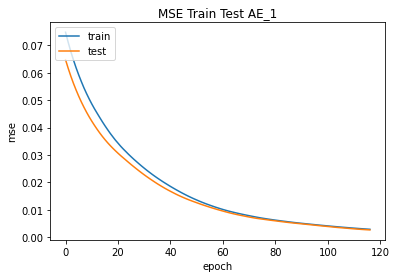

Epoch 00131: early stopping
Min error: 0.0058038681745529175
-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00144: early stopping
Min error: 0.009586031548678875
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_2/assets


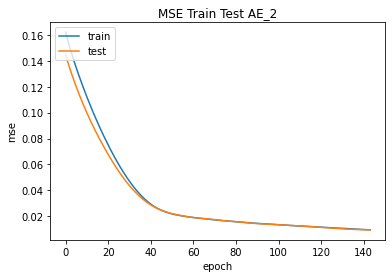

Epoch 00089: early stopping
Min error: 0.008862541057169437
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_2/assets


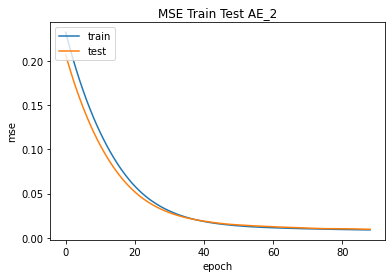

Epoch 00120: early stopping
Min error: 0.008698437362909317
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_2/assets


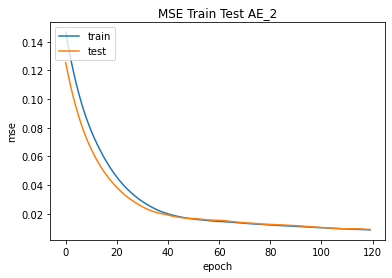

Min error: 0.006319417152553797
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_2/assets


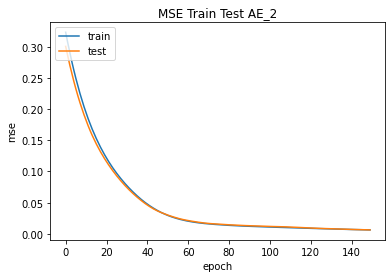

Epoch 00112: early stopping
Min error: 0.01118112076073885
Epoch 00130: early stopping
Min error: 0.008129705674946308
-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00101: early stopping
Min error: 0.01289003249257803
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_3/assets


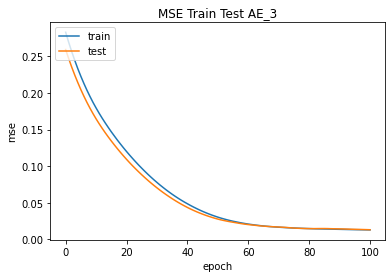

Min error: 0.007245725952088833
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_3/assets


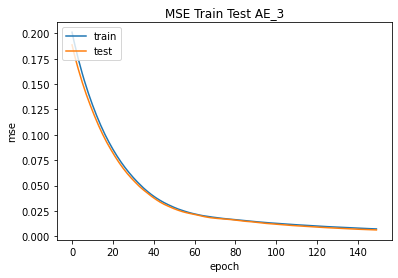

Epoch 00123: early stopping
Min error: 0.010735942050814629
Min error: 0.013519542291760445
Epoch 00136: early stopping
Min error: 0.009094955399632454
Epoch 00131: early stopping
Min error: 0.012862463481724262
-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.010317696258425713
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_4/assets


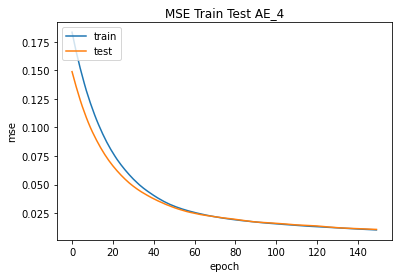

Epoch 00101: early stopping
Min error: 0.005515120457857847
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_4/assets


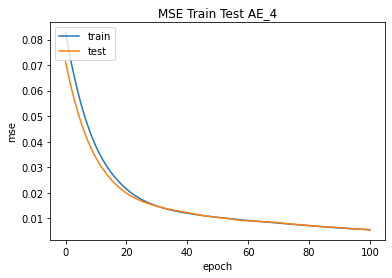

Epoch 00120: early stopping
Min error: 0.007183899637311697
Epoch 00097: early stopping
Min error: 0.007859372533857822
Epoch 00135: early stopping
Min error: 0.008962021209299564
Epoch 00088: early stopping
Min error: 0.008782701566815376
-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00091: early stopping
Min error: 0.004700411576777697
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_5/assets


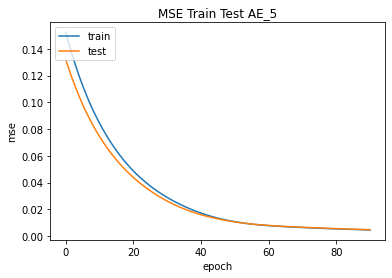

Min error: 0.007036485709249973
Min error: 0.008840512484312057
Epoch 00109: early stopping
Min error: 0.007926755584776402
Epoch 00127: early stopping
Min error: 0.00747483316808939
Min error: 0.010185408405959606
-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Min error: 0.010018362663686275
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_6/assets


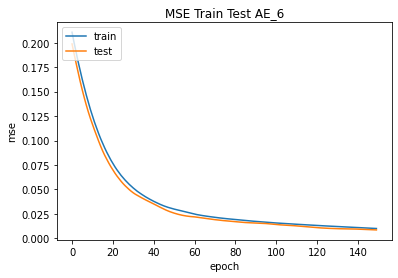

Min error: 0.010205769911408424
Epoch 00097: early stopping
Min error: 0.011143995448946953
Epoch 00121: early stopping
Min error: 0.009481683373451233
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_6/assets


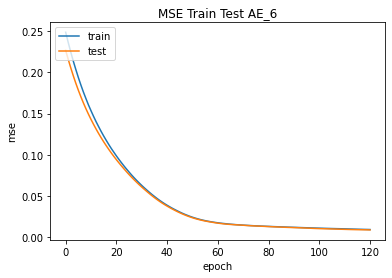

Epoch 00094: early stopping
Min error: 0.008653824217617512
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_6/assets


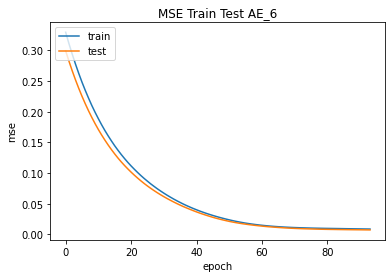

Epoch 00106: early stopping
Min error: 0.008402044884860516
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_6/assets


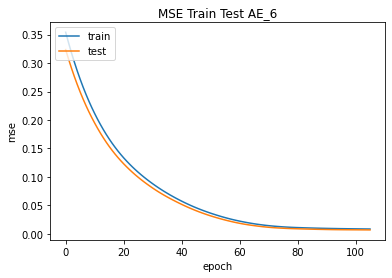

-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00146: early stopping
Min error: 0.005218170117586851
INFO:tensorflow:Assets written to: /Users/clara/Projects/A4_Cube/Codes/Strobler/pca/Models/Autoencoder_7/assets


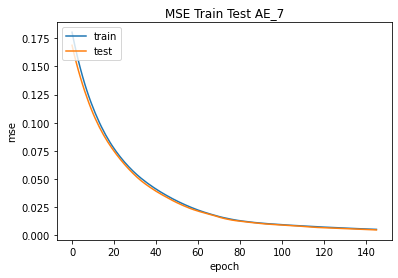

Epoch 00099: early stopping
Min error: 0.008938832208514214
Epoch 00126: early stopping
Min error: 0.009146506898105145
Epoch 00149: early stopping
Min error: 0.0075445473194122314
Epoch 00137: early stopping
Min error: 0.010447964072227478
Epoch 00133: early stopping
Min error: 0.0069230711087584496
Running time AEs --- minutes ----5.682370563348134


In [25]:
# early stopping
es = keras.callbacks.EarlyStopping(monitor = 'mse', mode = 'min', min_delta = 0.001, verbose = 2, patience = 12) 

start = time.time()

for ae in range(n_clusters):

    lowest_error = 100000000

    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')

    ## Create a folder for the AE
    # Model filepaths
    folder = f'Autoencoder_{ae}'
    mf = os.path.join(model_filepath, folder)
    if not os.path.exists(mf):
          os.mkdir(mf)
    # Figures filepaths
    mf2 = os.path.join(figures_filepath, 'Training')
    if not os.path.exists(mf2):
          os.mkdir(mf2)
    mf3 = os.path.join(figures_filepath, 'Error')
    if not os.path.exists(mf3):
          os.mkdir(mf3)
    mf4 = os.path.join(figures_filepath, 'Reflectance')
    if not os.path.exists(mf4):
          os.mkdir(mf4)


    ## Prepare training data
    print('Preparing training data...')

    
    # Data of the selected pixels
    data = np.transpose(training_data[:, ae, :])


    ## Train AE
    print('Training the model...')
    for n in range(6):
        # Create model
        model = Sequential()

        # Create layers
        model.add(Dense(units=10, activation='linear', input_dim=len(bands)))
        model.add(Dense(units=len(bands), activation='linear'))

        # Compile model (a traditional default value for the learning rate is 0.1 or 0.01)
        opt = keras.optimizers.Adam(learning_rate=0.001)
        tf.keras.losses.MeanSquaredError(reduction="auto", name="mean_squared_error")
        model.compile(optimizer=opt, loss="mean_squared_error", metrics=['mse'])

        # Train
        X_train, X_test = train_test_split(data, test_size=0.2, random_state=1)
        history = model.fit(x=X_train, y=X_train,
                            epochs=150,
                            batch_size= None,
                            shuffle=True,
                            validation_data=(X_test,X_test),
                            verbose=0,
                            callbacks=[es])

        # Save best model
        error = min(history.history['mse'])
        print(f'Min error: {error}')

        if error < lowest_error:
            lowest_error = error
            model.save(mf, overwrite=True, include_optimizer=True)
            # Plot train-test curves
            plt.plot(history.history['mse'])
            plt.plot(history.history['val_mse'])
            plt.title(f'MSE Train Test AE_{ae}')
            plt.ylabel('mse')
            plt.xlabel('epoch')
            plt.legend(['train', 'test'], loc='upper left')
            plt.savefig(f'{mf2}/traintestCurvesAE_{ae}.png', format='png', dpi=300)
            plt.show()
        pass

end = time.time()

print(f'Running time AEs --- minutes ----{(end-start)/60}')

# Predictions

# PREDICT TRAIN DATA

In [26]:
TRAINpredictions = []
for ae in list(range(n_clusters)):

    mf = f'{model_filepath}/Autoencoder_{ae}/'
    
    # Upload best model
    model = keras.models.load_model(mf)
       
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    TRAINpredicted_or = model.predict(x=TRAINarray_ae, verbose=1)
    
    # Convert to original shape
    TRAINpredicted = TRAINpredicted_or.transpose()
    TRAINpredicted = TRAINpredicted.reshape(trainArray.shape[1], trainArray.shape[0], trainArray.shape[2], trainArray.shape[3])
    images = []
    for img in range(trainArray.shape[0]):
        bands_img = []
        for b in range(trainArray.shape[1]):
            band = TRAINpredicted[b, img, :, :]
            bands_img.append(band)
        images.append(bands_img)
    TRAINpredicted = np.array(images)
    TRAINpredictions.append(TRAINpredicted)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

TRAINpredictions = np.array(TRAINpredictions)

Predicting autoencoder 0...
98213/98213 [==============================] - 90s 918us/step
Prediction time AE_0 ---minutes--- 1.5451508323351542
Predicting autoencoder 1...
98213/98213 [==============================] - 87s 881us/step
Prediction time AE_1 ---minutes--- 1.4686798493067423
Predicting autoencoder 2...
98213/98213 [==============================] - 118s 1ms/step
Prediction time AE_2 ---minutes--- 1.9886203845342
Predicting autoencoder 3...
98213/98213 [==============================] - 106s 1ms/step
Prediction time AE_3 ---minutes--- 1.8134168942769369
Predicting autoencoder 4...
98213/98213 [==============================] - 99s 1ms/step
Prediction time AE_4 ---minutes--- 1.6796428004900614
Predicting autoencoder 5...
98213/98213 [==============================] - 95s 967us/step
Prediction time AE_5 ---minutes--- 1.6166686018308003
Predicting autoencoder 6...
98213/98213 [==============================] - 130s 1ms/step
Prediction time AE_6 ---minutes--- 2.189357650279999
P

**SHOW PIXEL RECONSTRUCTION (MOST REPRESENTATIVE PIXEL PER CLUSTER)**

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------


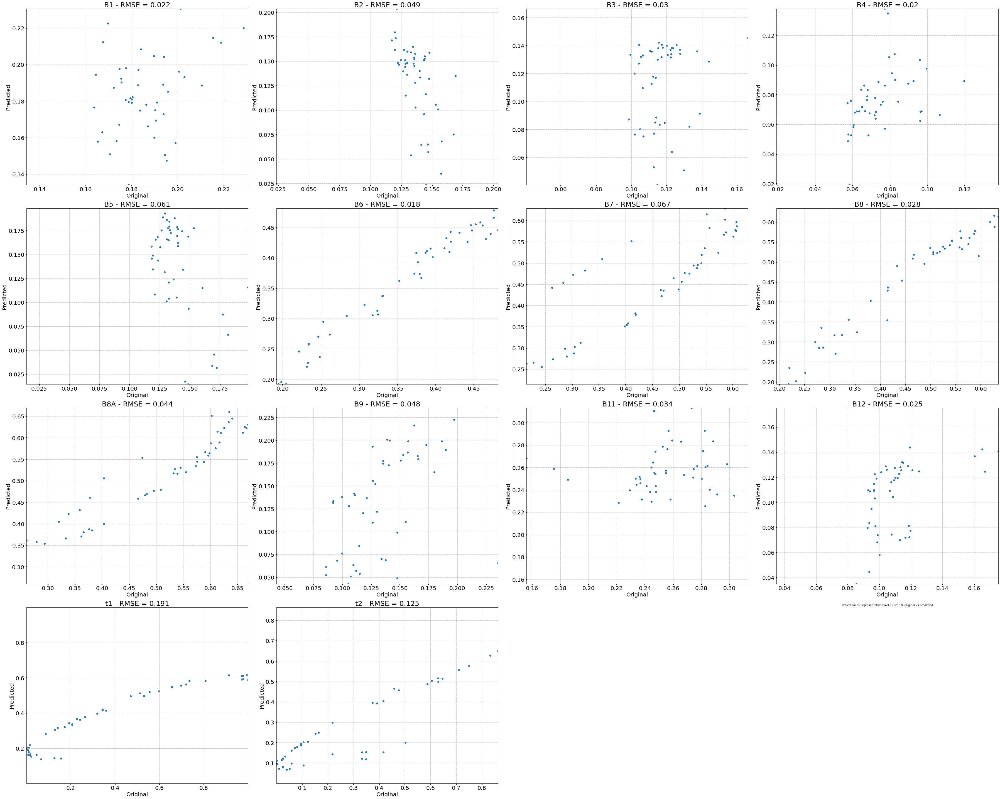

-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------


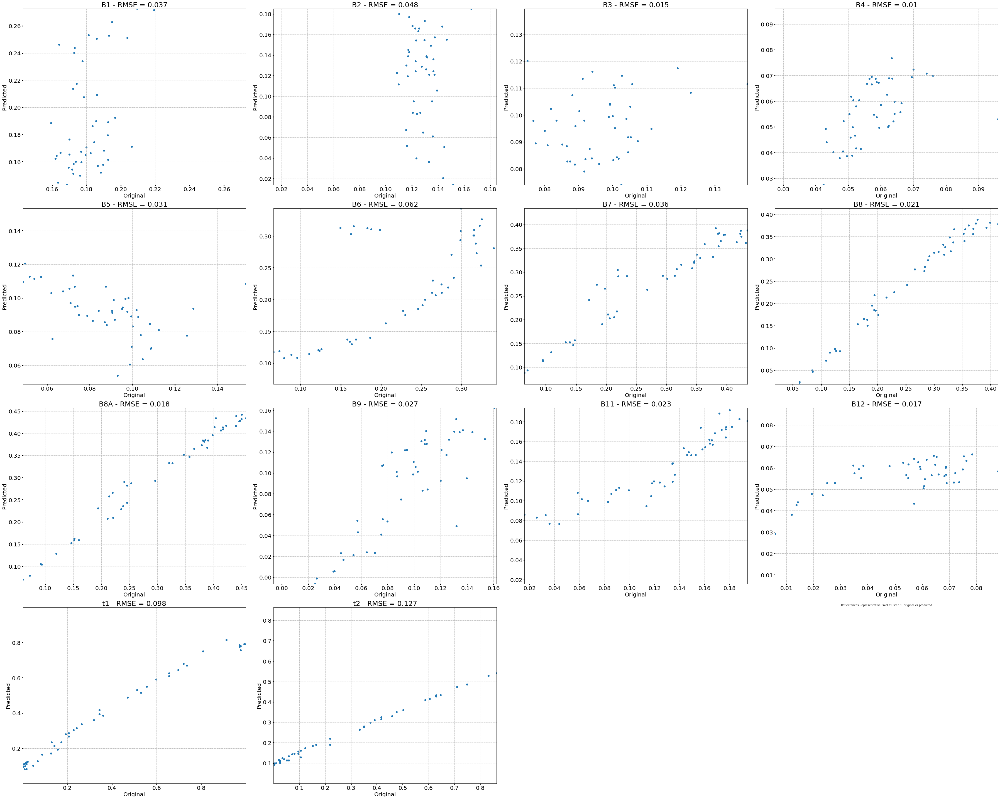

-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------


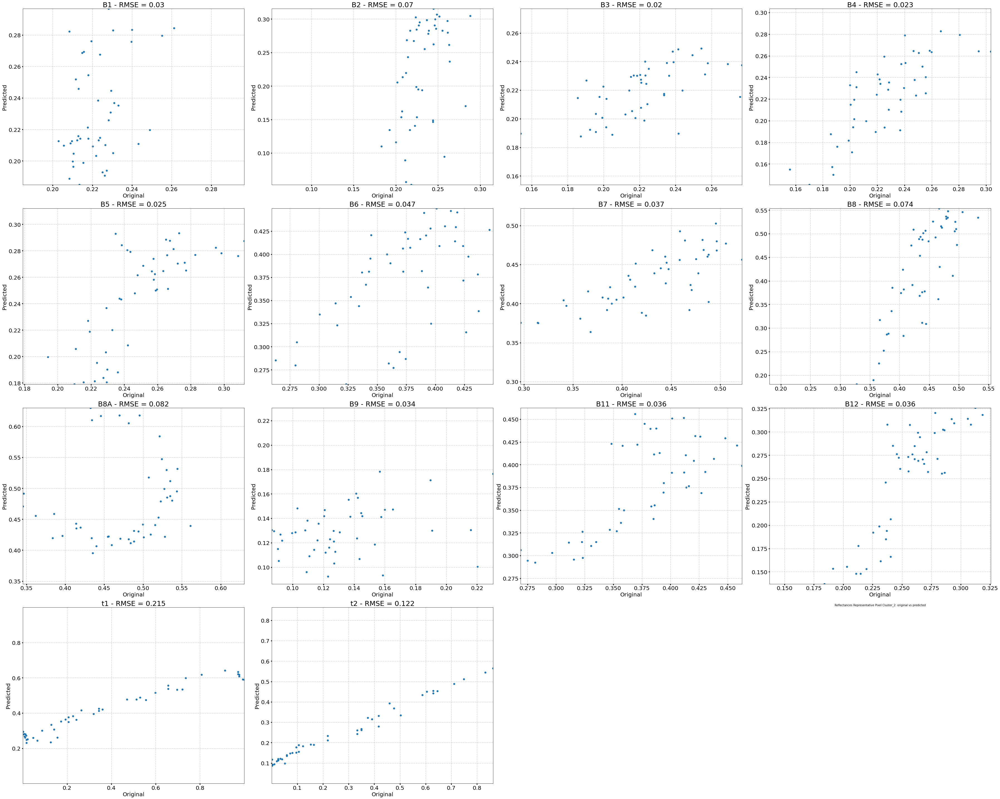

-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------


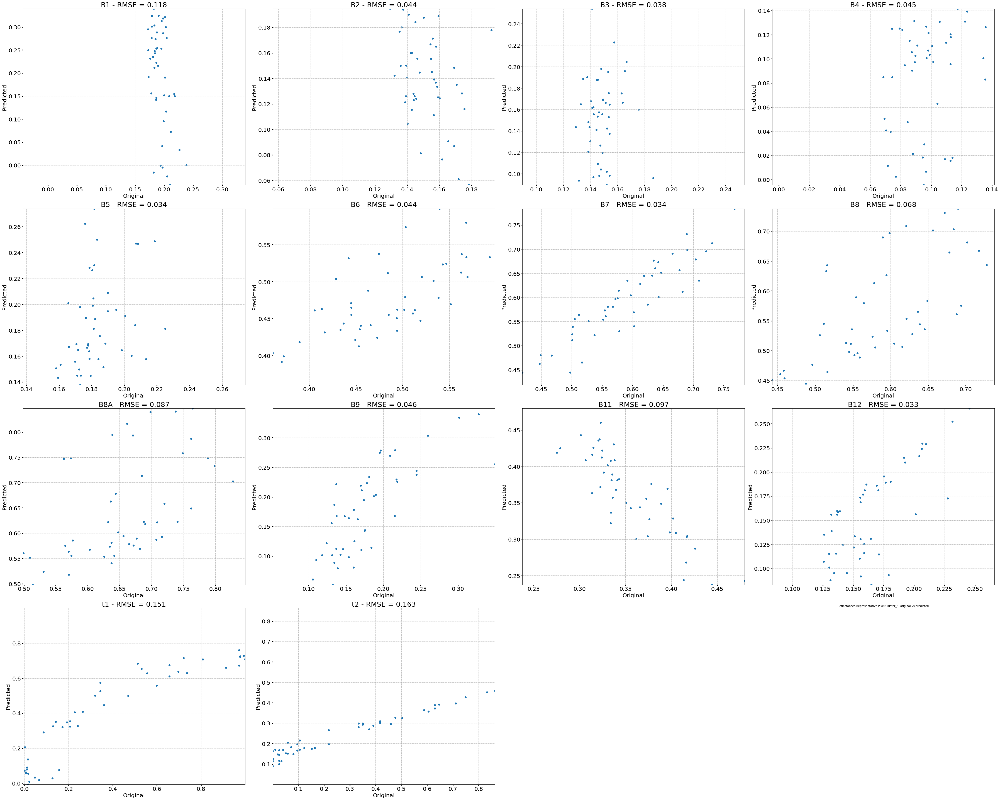

-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------


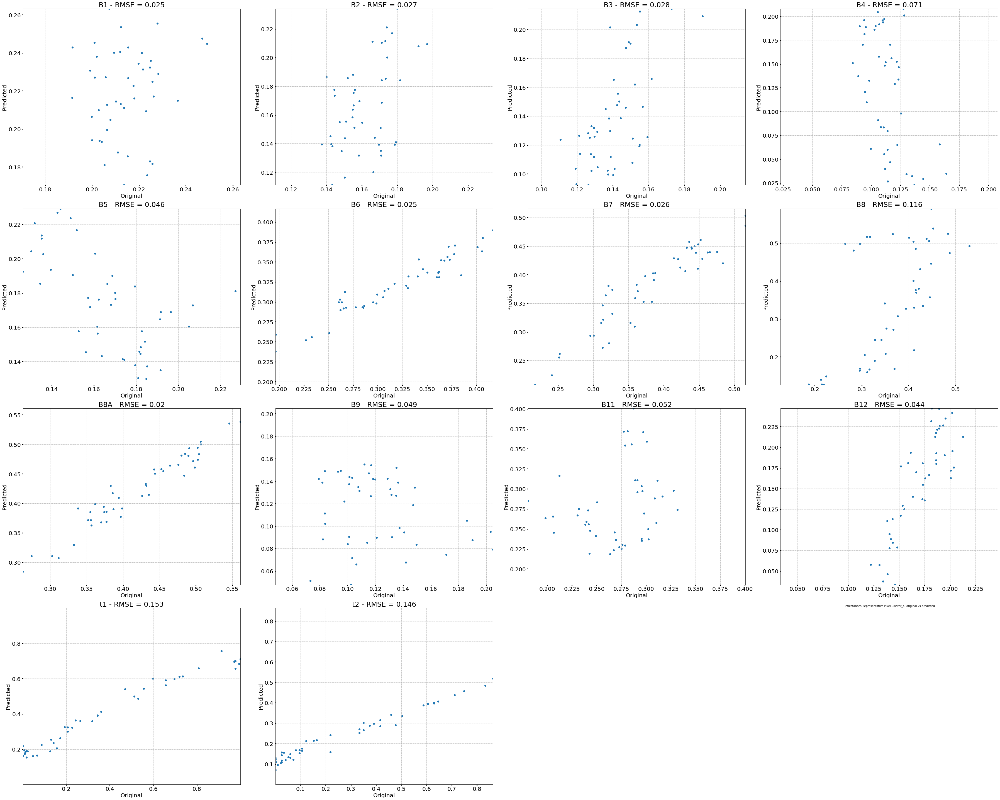

-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------


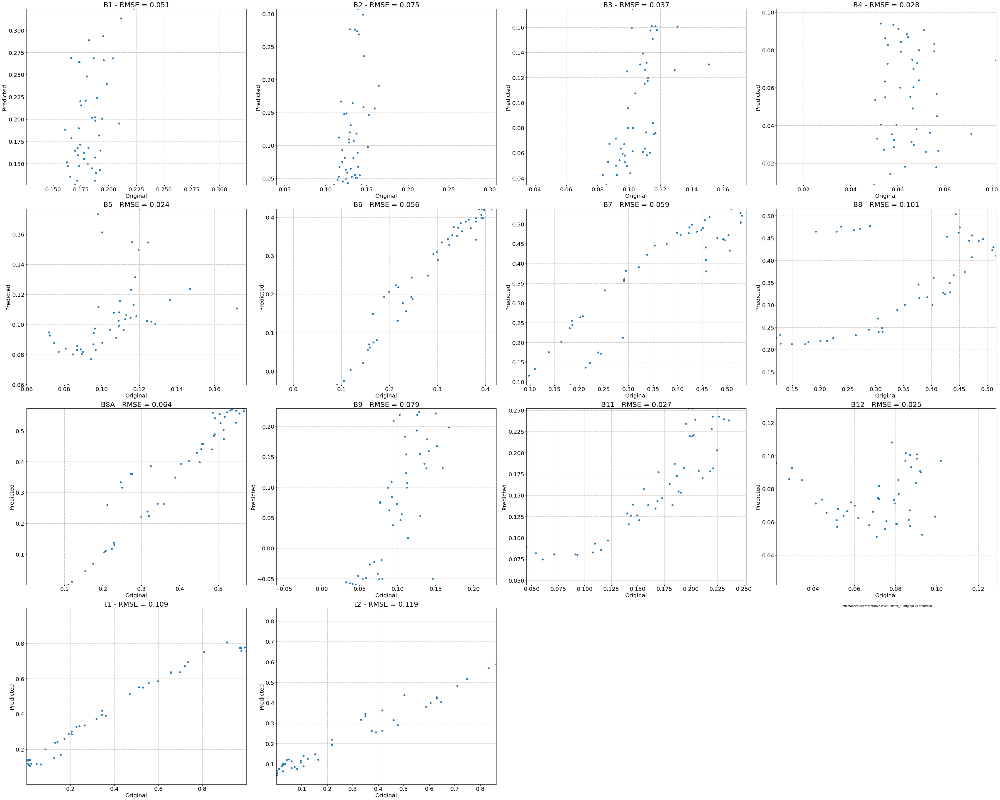

-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------


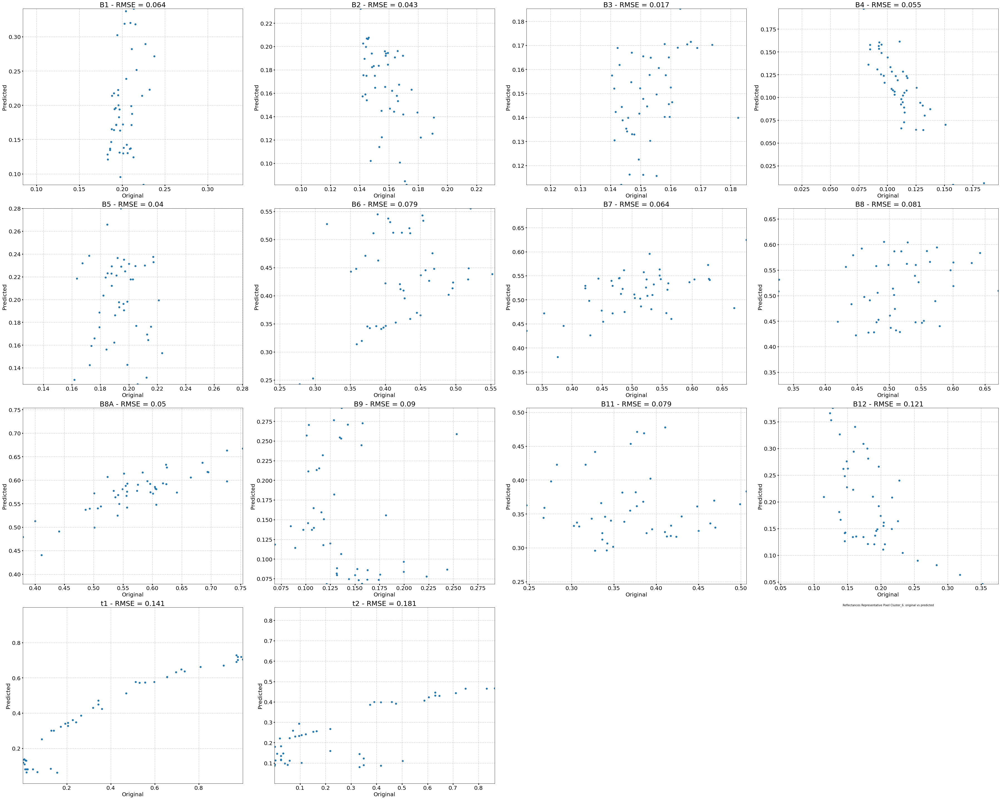

-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------


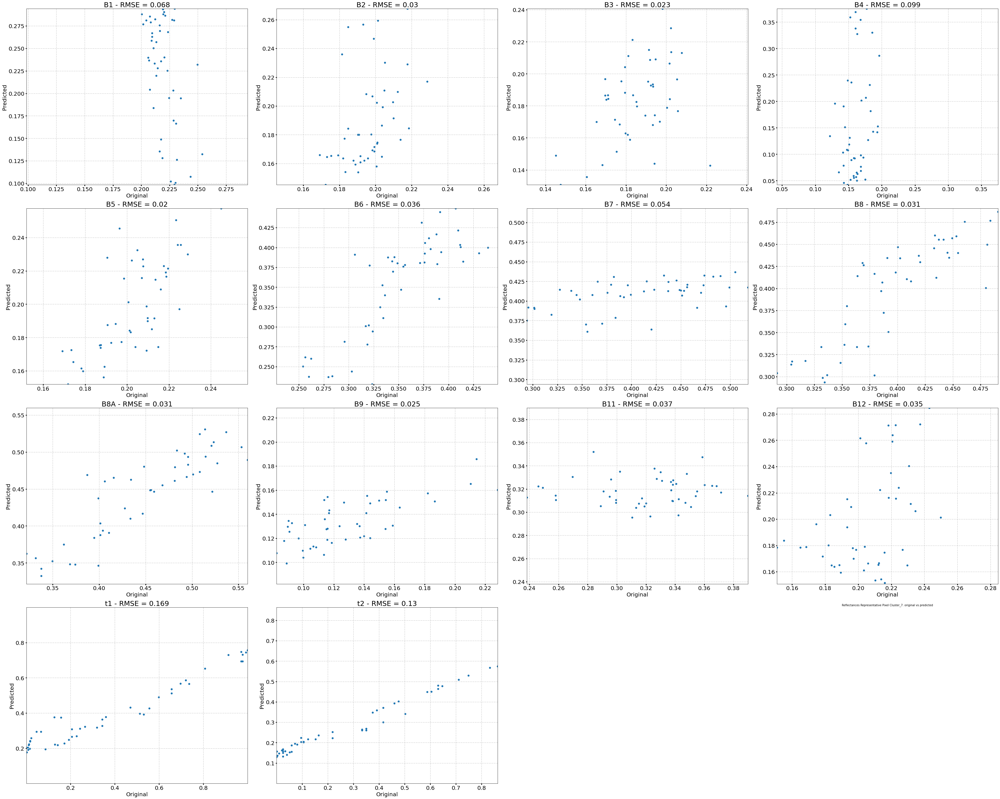

In [27]:
from matplotlib.cbook import flatten
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Show reflectances for each AE
for ae in range(n_clusters):
    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')
    
    # Plot reflectances original pixel vs. reconstructed
    TRAINpredicted = TRAINpredictions[ae]
    pixels = rep_pix_allCluster[ae]
    pixel = pixels[0]
    fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
    rms_l = []
    
    # reflectance bands: B1, B2, B3, B4, B5
    for sp in range(n_figures):
        ori_sublist = []
        pre_sublist = []
        for pixel in pixels:
            ori_pixel = list(trainArray[:,sp, pixel[0], pixel[1]])
            ori_sublist.append(ori_pixel)
            pre_pixel = list(TRAINpredicted[:,sp, pixel[0], pixel[1]])
            pre_sublist.append(pre_pixel)
        #print(ori_sublist)
        #print(pre_sublist)
        ori = list(flatten(ori_sublist))
        pre = list(flatten(pre_sublist))
        rms = round(mean_squared_error(ori, pre, squared=False),3)
        rms_l.append(rms)
        ax = axs[rows[sp], columns[sp]]
        im = ax.scatter(ori, pre)
        ax.set_xlim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_ylim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_title(f'{bands[sp]} - RMSE = {rms}', fontsize=25)
        ax.set_xlabel('Original', fontsize=20)
        ax.set_ylabel('Predicted', fontsize=20)
        ax.grid(True, linestyle='-.')
        ax.tick_params(labelsize=20, width=3)
    
    # delete empty figures
    for sp in range(n_figures, n_rows*n_cols):
        axs[rows[sp], columns[sp]].set_axis_off()

    plt.title(f'Reflectances Representative Pixel Cluster_{ae}: original vs predicted', fontsize=10)
    plt.tight_layout()
    plt.savefig(f'{mf4}/OriginalvsReconstructed_AE_{ae}.png', format='png', dpi=300)
    plt.show()

# PREDICT TEST DATA

In [28]:
predictions = []
for ae in list(range(n_clusters)):

    mf = f'{model_filepath}/Autoencoder_{ae}/'
    
    # Upload best model
    model = keras.models.load_model(mf)
       
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    predicted_or = model.predict(x=array_ae, verbose=1)

    # Convert to original shape
    predicted = predicted_or.transpose()
    predicted = predicted. reshape(testArray.shape[0], testArray.shape[1], testArray.shape[2])
    predictions.append(predicted)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

predictions = np.array(predictions)

Predicting autoencoder 0...
2136/2136 [==============================] - 2s 710us/step
Prediction time AE_0 ---minutes--- 0.02803848187128703
Predicting autoencoder 1...
2136/2136 [==============================] - 1s 680us/step
Prediction time AE_1 ---minutes--- 0.025508753458658853
Predicting autoencoder 2...
2136/2136 [==============================] - 2s 902us/step
Prediction time AE_2 ---minutes--- 0.03359216849009196
Predicting autoencoder 3...
2136/2136 [==============================] - 2s 851us/step
Prediction time AE_3 ---minutes--- 0.031696999073028566
Predicting autoencoder 4...
2136/2136 [==============================] - 2s 704us/step
Prediction time AE_4 ---minutes--- 0.03479079802831014
Predicting autoencoder 5...
2136/2136 [==============================] - 2s 825us/step
Prediction time AE_5 ---minutes--- 0.030581263701121013
Predicting autoencoder 6...
2136/2136 [==============================] - 3s 2ms/step
Prediction time AE_6 ---minutes--- 0.05651861826578776
Predi

**Calculate error: RMSE**

In [29]:
error_list = []
ae=0
for predicted in predictions:    
    print(f'Calculating error autoencoder {ae}...')
    ae=ae+1
    
    # RMSE y=bands of one image -> predicted vs original + mean of the RMSE between all images
    dif = (predicted[:-2,:,:]-testArray[:-2,:,:])**2
    suma = np.sum(dif, axis = 0)
    div = suma/(testArray.shape[0]-2)
    square = div**(1/2)
    error_list.append(square)

error_list = np.array(error_list)

Calculating error autoencoder 0...
Calculating error autoencoder 1...
Calculating error autoencoder 2...
Calculating error autoencoder 3...
Calculating error autoencoder 4...
Calculating error autoencoder 5...
Calculating error autoencoder 6...
Calculating error autoencoder 7...


**Plot error**

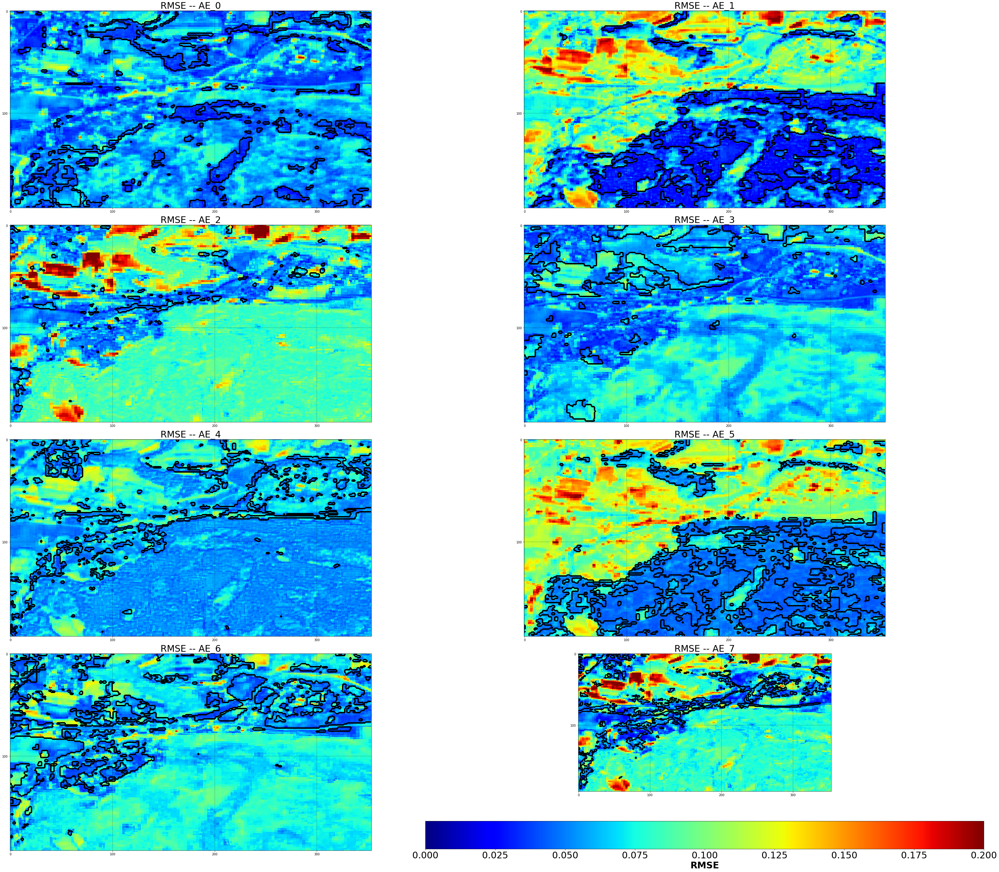

In [30]:
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) +1
n_cols = int(math.ceil(n_figures/n_rows))
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# RMSE in each subplot: plot error matrices
cm = 'jet'
for ae in range(n_figures):
    mean = error_list[ae]
    cluster = labels==ae
    ax = axs[rows[ae], columns[ae]]
    im = ax.imshow(mean, cmap=cm, vmin=0, vmax=0.2)
    ax.contour(cluster, colors='black', linewidths=1.5)
    ax.set_xticks(np.arange(mean.shape[1]+1, step=100))
    ax.set_yticks(np.arange(mean.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{ae}', fontsize=30)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
plt.tight_layout()
plt.savefig(f'{mf3}/RMSE_all_AE.png', format='png', dpi=300)
plt.show()

**Min Error of All Autoencoders in AOI**

In [31]:
##hyperparameters (visualization)
vmin= 0.04
vmax=0.08

-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------


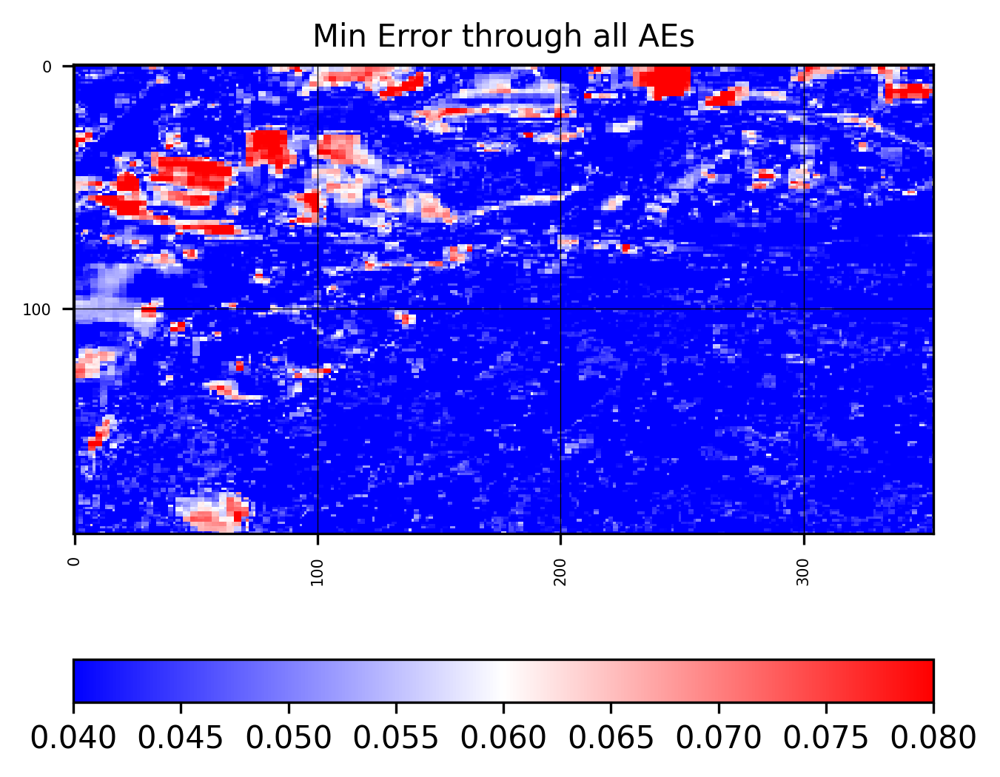

In [41]:
## Min Error of All Autoencoders
print(f'''-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------''')
error = error_list.min(axis=0)
# Plot min error
fig, ax = plt.subplots(figsize=(5,5), dpi=300)
ax = plt.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin, vmax=vmax)
plt.xticks(np.arange(error.shape[1]+1, step=100), fontsize=5, rotation=90)
plt.yticks(np.arange(error.shape[0]+1, step=100), fontsize=5, rotation=0)
plt.grid(color='black', linewidth=0.3)
plt.title(f'Min Error through all AEs', fontsize=10)
fig.colorbar(ax, orientation='horizontal')
plt.savefig(f'{mf3}/min_error.png', format='png', dpi=300)
plt.show()

**REPRESENT MIN ERROR BOUNDING CLUSTERS**

<Figure size 432x288 with 0 Axes>

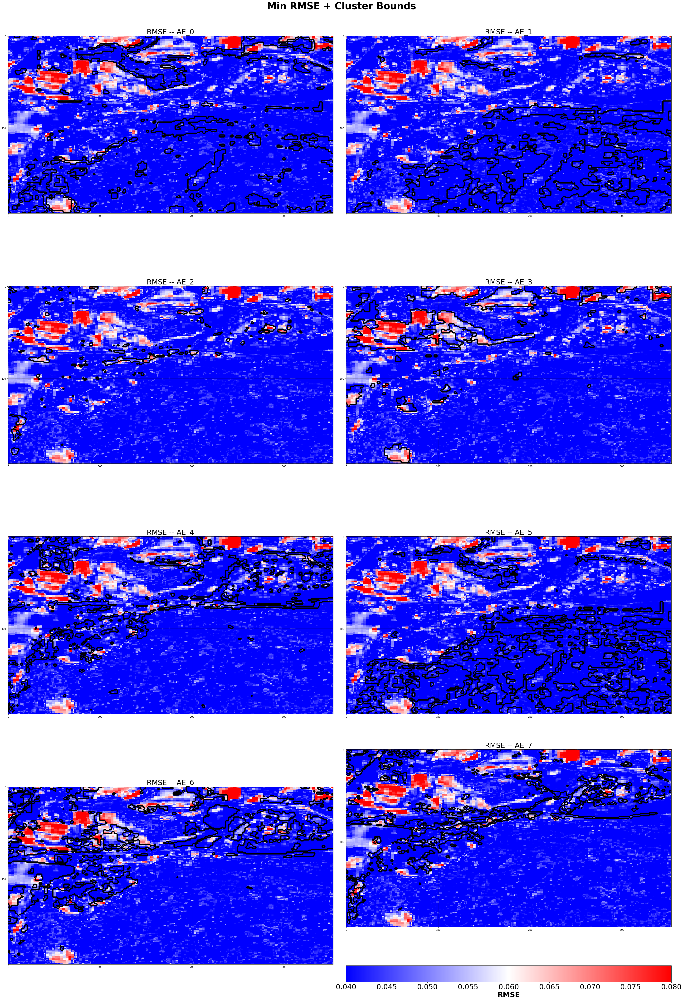

In [33]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = 4 
n_cols = 2
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Min RMSE + Cluster Bounds', fontsize = 40, fontweight="bold")

# RMSE in each subplot: plot error matrices
cm = 'jet'
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    im = ax.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin, vmax=vmax)
    ax.contour(cluster, colors='black', linewidths=1.75)
    ax.set_xticks(np.arange(error.shape[1]+1, step=100))
    ax.set_yticks(np.arange(error.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{sp}', fontsize=30)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
fig.subplots_adjust(top=0.9)
plt.tight_layout()
plt.savefig(f'{mf3}/minRMSE_ClusterBounds.png', format='png', dpi=300)
plt.show()

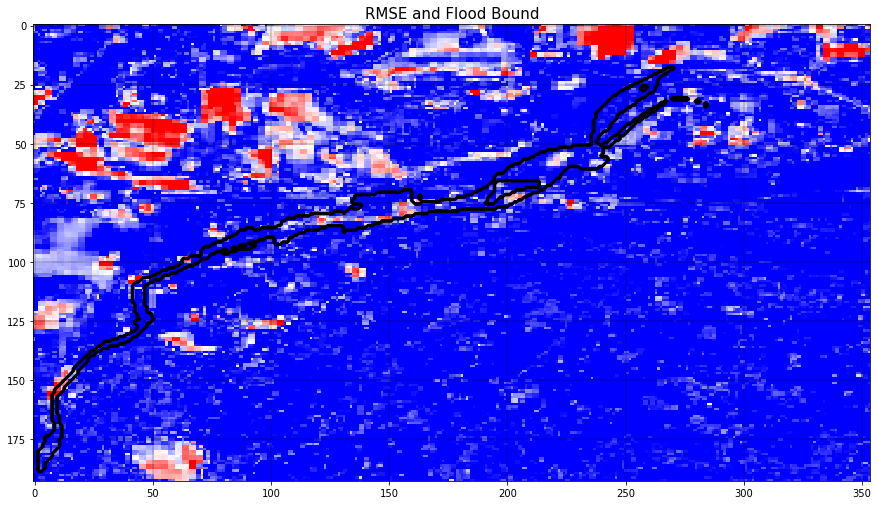

In [43]:
plt.figure(figsize = (15,15))

files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.','Strobler', 'Test')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
        # Labels
        flood = gdal_array.LoadFile(path_images+f)

error = error_list.min(axis=0)
plt.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin, vmax=vmax)
plt.contour(flood==1, colors='black', linewidths=1.5)
plt.grid(color='black', linewidth=0.3)
plt.title(f'RMSE and Flood Bound', fontsize=15)
#fig.colorbar(ax, orientation='horizontal')
plt.savefig(f'{mf3}/minError_FloodBound.png', format='png', dpi=300)
plt.show()

# Reconstruction

**AUTOENCODERS**

In [36]:
# Autoencoder of each pixel
for y in range(testArray.shape[1]):
    for x in range(testArray.shape[2]):
        for c in range(n_clusters):
            if error[y,x] == error_list[c, y, x]:
                error[y,x] = c
            else:
                pass

<Figure size 432x288 with 0 Axes>

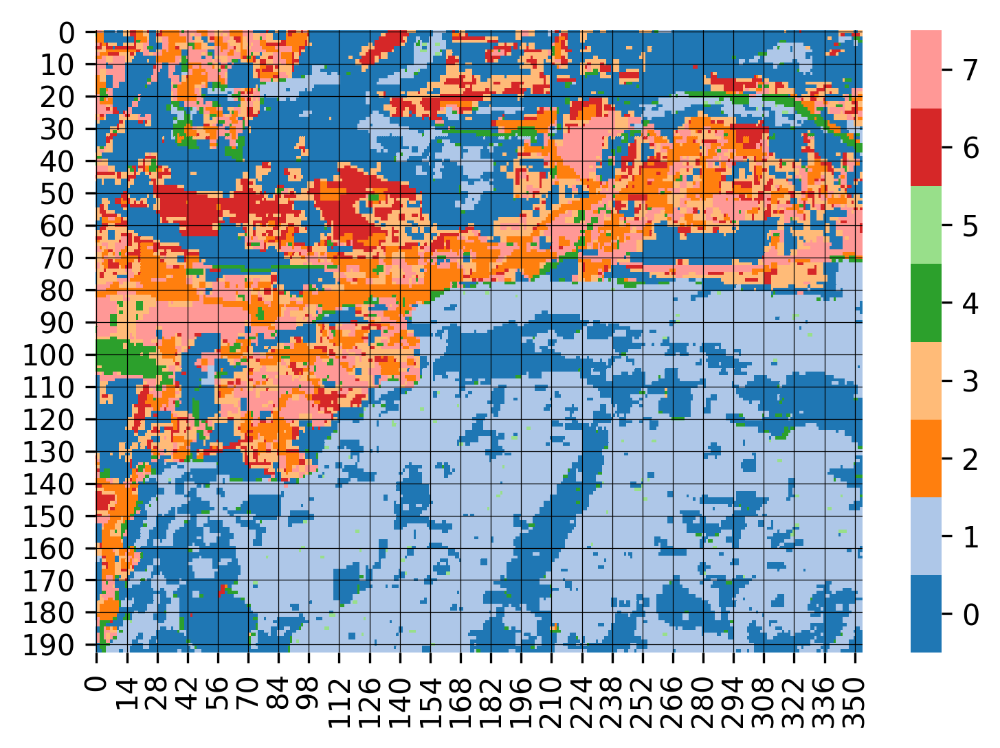

In [37]:
plt.figure()

# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(error, cmap=cmap) 

# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)

#save and plot
plt.savefig(f'{figures_filepath}/Clusters_Autoencoders.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE**

In [38]:
predictions.shape

(8, 14, 193, 354)

In [39]:
best_pred = []
for c in range(n_clusters):
    cluster = error == c
    predicted = predictions[c]
    pred_cluster = cluster * predicted
    best_pred.append(pred_cluster)
best_pred = np.array(best_pred)
best_pred = np.sum(best_pred, axis = 0)
best_pred.shape

(14, 193, 354)

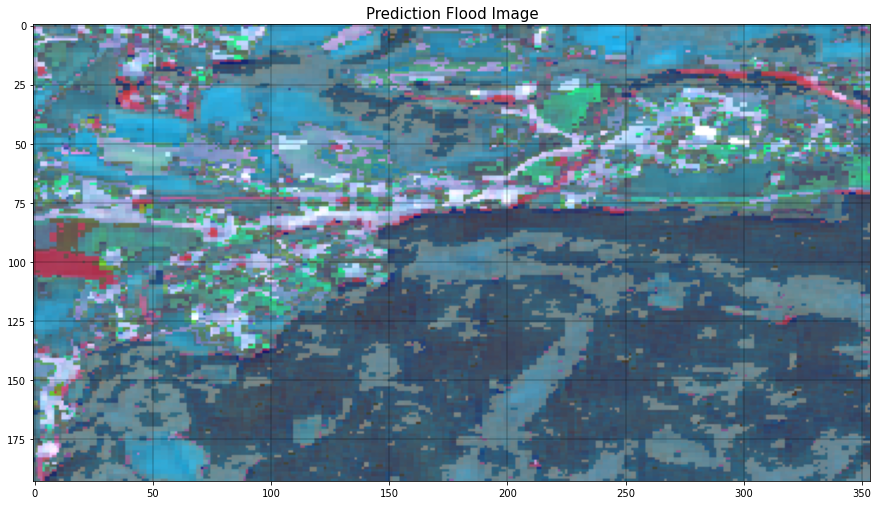

In [40]:
plt.figure(figsize = (15,15))
image = best_pred
img = np.dstack((image[3, ...]*4, image[2, ...]*4, image[1, ...]*4))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'Prediction Flood Image', fontsize=15)
#plt.savefig(f'{figures_filepath}/prediction_image_flood.png', format='png', dpi=300)
plt.show()

# Export to tif

In [42]:
np.savetxt("foo.csv", error, delimiter=",")

In [43]:
def write_tiff(m, tifsrc, path_out, name):
    rows = tifsrc.RasterXSize
    cols = tifsrc.RasterYSize
    prj_wkt = tifsrc.GetProjectionRef()
    geotransform = tifsrc.GetGeoTransform()
    driver = gdal.GetDriverByName('GTiff')
    ds = driver.Create(path_out.format(name), rows, cols, 1, gdal.GDT_Float32)
    ds.SetGeoTransform(geotransform)
    ds.SetProjection(prj_wkt)
    outband=ds.GetRasterBand(1)
    outband.WriteArray(m)
    ds = None
    outband = None
'''m=matriz de datos,
tifsrc = objeto tiff generado por gdal (gdal.Open),
path_out = ruta de la carpeta donde lo quieres guardar,
name = nombre del archivo (has de incluirle la extension .tif)'''

'm=matriz de datos,\ntifsrc = objeto tiff generado por gdal (gdal.Open),\npath_out = ruta de la carpeta donde lo quieres guardar,\nname = nombre del archivo (has de incluirle la extension .tif)'

In [44]:
mask_tif='/Users/clara/Desktop/pr.tif'
tifsrc = gdal.Open(mask_tif)

In [45]:
write_tiff(error, tifsrc, '/Users/clara/Desktop/', 'error.tif')

AttributeError: 'NoneType' object has no attribute 'RasterXSize'

In [ ]:
#def write_tiff(m, tifsrc, path_out, name):

rows = tifsrc.RasterXSize
cols = tifsrc.RasterYSize

'''m=matriz de datos,
tifsrc = objeto tiff generado por gdal (gdal.Open),
path_out = ruta de la carpeta donde lo quieres guardar,
name = nombre del archivo (has de incluirle la extension .tif)'''

In [ ]:
prj_wkt = tifsrc.GetProjectionRef()


In [ ]:
geotransform = tifsrc.GetGeoTransform()


In [ ]:
driver = gdal.GetDriverByName('GTiff')


In [ ]:
path_out = '/Users/clara/Desktop/'
name = 'error.tif'
path_out.format(name)

In [ ]:
ds = driver.Create('/Users/clara/Desktop/error.tif', rows, cols, 1, gdal.GDT_Float32)
print(ds)

In [ ]:
ds.SetGeoTransform(geotransform)


In [ ]:
ds.SetProjection(prj_wkt)
outband=ds.GetRasterBand(1)
outband.WriteArray(error)
ds = None
outband = None

# End :)